In [1]:
import seaborn as sns
import random
import tensorflow as tf
import numpy as np
import absl.logging
import wandb
import os
from PIL import Image

import pprint
#import tensorflow_datasets as tfds
from wandb.keras import WandbCallback
from keras import Sequential
from tqdm import tqdm
from matplotlib import pyplot as plt
from sklearn.metrics import confusion_matrix
from tensorflow import keras
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
from models import build_model, ARCHITECTURES

%matplotlib inline
wandb.login()
absl.logging.set_verbosity(absl.logging.ERROR)

ModuleNotFoundError: No module named 'tensorflow'

In [ ]:
if tf.test.gpu_device_name():
    print('GPU found')
else:
    print("No GPU found")
print(tf.__version__)

gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)
len(gpus)

In [3]:
CONFIG = {
    "epochs": 30,
    "batch_size": 32,
    "learning_rate": 0.001,
    "beta_1": 0.9,
    "beta_2": 0.999,    
}

# Vegetable image dataset
https://www.kaggle.com/datasets/misrakahmed/vegetable-image-dataset

15 tried - bean, bitter gourd, bottle gourd, brinjal, broccoli, cabbage, capsicum, carrot, cauliflower, cucumber, papaya, potato, pumpkin, radish and tomato

21 000 obrazkov, 1400 obrazkov na triedu - split 70:15:15

Robili sme downsampling z 224 na 112 celeho datasetu.

In [4]:

#def resize_data(dir, output_dir, size: tuple):
#
#    for root, dirs, files in os.walk(dir):
#        for file in files:
#            if file.endswith(".jpg") or file.endswith(".jpeg") or file.endswith(".png"):
#                image_path = os.path.join(root, file)
#                with Image.open(image_path) as img:
#                    downsampled_img = img.resize(size)
#                    downsampled_image_path = os.path.join(str(root).replace(dir, output_dir))
#
#                    if not os.path.exists(downsampled_image_path):
#                        os.makedirs(downsampled_image_path)
#
#                    #downsampled_img = downsampled_img.convert("RGB")
#                    downsampled_img.save(os.path.join(downsampled_image_path, file))
#
#
#resize_data("data/original", "data/processed", (112, 112))


In [5]:
def normalize_img(image, label):
  return tf.cast(image, tf.float32) / 255., label

#
# builder = tfds.ImageFolder('data/processed/')
# print(builder.info)  # num examples, labels... are automatically calculated
#
# ds_valid = builder.as_dataset(split='validation', shuffle_files=True, as_supervised=True)
# ds_valid = ds_valid.map(normalize_img, num_parallel_calls=tf.data.AUTOTUNE)
# ds_valid = ds_valid.batch(128)
# ds_valid = ds_valid.cache()
# ds_valid = ds_valid.prefetch(tf.data.AUTOTUNE)
#
# ds_test = builder.as_dataset(split='test', shuffle_files=True, as_supervised=True)
# ds_test = ds_test.map(normalize_img, num_parallel_calls=tf.data.AUTOTUNE)
# ds_test = ds_test.batch(128)
# ds_test = ds_test.cache()
# ds_test = ds_test.prefetch(tf.data.AUTOTUNE)
#
# ds_train = builder.as_dataset(split='train', shuffle_files=True, as_supervised=True)
# ds_train = ds_train.map(normalize_img, num_parallel_calls=tf.data.AUTOTUNE)
# ds_train = ds_train.batch(128)
# ds_train = ds_train.cache()
# ds_train = ds_train.prefetch(tf.data.AUTOTUNE)



# Define constants

BATCH_SIZE = CONFIG["batch_size"]
AUTOTUNE = tf.data.AUTOTUNE
#normalization_layer = tf.keras.layers.Rescaling(scale=1./255)


# Define train dataset
ds_train = tf.keras.preprocessing.image_dataset_from_directory('data/processed/train',image_size=(112,112),seed=42,batch_size=BATCH_SIZE)
class_names = ds_train.class_names
ds_train = ds_train.map(normalize_img)
ds_train = ds_train.cache().prefetch(AUTOTUNE)

# Define validation dataset
ds_valid = tf.keras.preprocessing.image_dataset_from_directory('data/processed/validation',image_size=(112,112),seed=42,batch_size=BATCH_SIZE)
ds_valid = ds_valid.map(normalize_img)
ds_valid = ds_valid.cache().prefetch(AUTOTUNE)

# Define test dataset
ds_test = tf.keras.preprocessing.image_dataset_from_directory('data/processed/test',image_size=(112,112),seed=42,batch_size=BATCH_SIZE)
ds_test = ds_test.map(normalize_img)
ds_test = ds_test.cache().prefetch(AUTOTUNE)


Found 15000 files belonging to 15 classes.


2023-04-12 15:33:56.909749: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-04-12 15:33:56.909789: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


Found 3000 files belonging to 15 classes.
Found 3000 files belonging to 15 classes.


In [6]:
image_batch, labels_batch = next(iter(ds_train))
print("Batch shapes - Images: {}, Labels: {}".format(image_batch.shape, labels_batch.shape))

Batch shapes - Images: (32, 112, 112, 3), Labels: (32,)


2023-04-12 15:33:57.282973: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2023-04-12 15:33:57.301463: W tensorflow/core/kernels/data/cache_dataset_ops.cc:856] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


In [7]:
class_names

['Bean',
 'Bitter_Gourd',
 'Bottle_Gourd',
 'Brinjal',
 'Broccoli',
 'Cabbage',
 'Capsicum',
 'Carrot',
 'Cauliflower',
 'Cucumber',
 'Papaya',
 'Potato',
 'Pumpkin',
 'Radish',
 'Tomato']

In [8]:
num_classes = len(class_names)

In [9]:


model = build_model(ARCHITECTURES[0][0])

model.compile(optimizer=keras.optimizers.Adam(learning_rate=CONFIG["learning_rate"]),
              loss=keras.losses.SparseCategoricalCrossentropy(),
              metrics=["accuracy"])


In [10]:
tf.keras.utils.plot_model(model, show_shapes=True, dpi=75)

You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) for plot_model/model_to_dot to work.


In [11]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 112, 112, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 56, 56, 16)       0         
 )                                                               
                                                                 
 re_lu (ReLU)                (None, 56, 56, 16)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 56, 56, 32)        4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 28, 28, 32)       0         
 2D)                                                             
                                                                 
 re_lu_1 (ReLU)              (None, 28, 28, 32)        0

In [12]:
CONFIG["arch"] = ARCHITECTURES[0][0]
run = wandb.init(project="zadanie2", name=ARCHITECTURES[0][0], config=CONFIG)
model.fit(ds_train, epochs=CONFIG["epochs"], validation_data=ds_valid, batch_size=CONFIG["batch_size"],
          callbacks=[
            WandbCallback(),
            EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
            ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=2, min_lr=1e-10, min_delta=0.0004, mode='min')])
run.finish()

wandb: WARNING The save_model argument by default saves the model in the HDF5 format that cannot save custom objects like subclassed models and custom layers. This behavior will be deprecated in a future release in favor of the SavedModel format. Meanwhile, the HDF5 model is saved as W&B files and the SavedModel as W&B Artifacts.


Epoch 1/30


2023-04-12 15:34:00.143238: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


469/469 [==============================] - ETA: 0s - loss: 1.1749 - accuracy: 0.6165

2023-04-12 15:34:07.372245: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best)... Done. 0.0s


469/469 [==============================] - 10s 20ms/step - loss: 1.1749 - accuracy: 0.6165 - val_loss: 0.6187 - val_accuracy: 0.8023 - lr: 0.0010
Epoch 2/30
467/469 [============================>.] - ETA: 0s - loss: 0.3986 - accuracy: 0.8781INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best)... Done. 0.0s


469/469 [==============================] - 9s 19ms/step - loss: 0.3985 - accuracy: 0.8780 - val_loss: 0.3718 - val_accuracy: 0.8873 - lr: 0.0010
Epoch 3/30
469/469 [==============================] - ETA: 0s - loss: 0.2246 - accuracy: 0.9346INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best)... Done. 0.0s


469/469 [==============================] - 9s 18ms/step - loss: 0.2246 - accuracy: 0.9346 - val_loss: 0.2435 - val_accuracy: 0.9317 - lr: 0.0010
Epoch 4/30
469/469 [==============================] - 7s 16ms/step - loss: 0.1423 - accuracy: 0.9565 - val_loss: 0.2729 - val_accuracy: 0.9293 - lr: 0.0010
Epoch 5/30
469/469 [==============================] - 7s 16ms/step - loss: 0.1073 - accuracy: 0.9687 - val_loss: 0.3114 - val_accuracy: 0.9220 - lr: 0.0010
Epoch 6/30
468/469 [============================>.] - ETA: 0s - loss: 0.0289 - accuracy: 0.9922INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best)... Done. 0.0s


469/469 [==============================] - 8s 18ms/step - loss: 0.0289 - accuracy: 0.9922 - val_loss: 0.1827 - val_accuracy: 0.9600 - lr: 1.0000e-04
Epoch 7/30
467/469 [============================>.] - ETA: 0s - loss: 0.0158 - accuracy: 0.9970INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best)... Done. 0.0s


469/469 [==============================] - 9s 18ms/step - loss: 0.0157 - accuracy: 0.9970 - val_loss: 0.1821 - val_accuracy: 0.9610 - lr: 1.0000e-04
Epoch 8/30
469/469 [==============================] - 7s 16ms/step - loss: 0.0112 - accuracy: 0.9982 - val_loss: 0.1829 - val_accuracy: 0.9620 - lr: 1.0000e-04
Epoch 9/30
469/469 [==============================] - 8s 16ms/step - loss: 0.0083 - accuracy: 0.9987 - val_loss: 0.1846 - val_accuracy: 0.9617 - lr: 1.0000e-04
Epoch 10/30
469/469 [==============================] - ETA: 0s - loss: 0.0063 - accuracy: 0.9993INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best)... Done. 0.0s


469/469 [==============================] - 9s 18ms/step - loss: 0.0063 - accuracy: 0.9993 - val_loss: 0.1784 - val_accuracy: 0.9613 - lr: 1.0000e-05
Epoch 11/30
466/469 [============================>.] - ETA: 0s - loss: 0.0058 - accuracy: 0.9993INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best)... Done. 0.0s


469/469 [==============================] - 8s 18ms/step - loss: 0.0058 - accuracy: 0.9993 - val_loss: 0.1783 - val_accuracy: 0.9613 - lr: 1.0000e-05
Epoch 12/30
469/469 [==============================] - 7s 15ms/step - loss: 0.0055 - accuracy: 0.9993 - val_loss: 0.1786 - val_accuracy: 0.9613 - lr: 1.0000e-05
Epoch 13/30
469/469 [==============================] - ETA: 0s - loss: 0.0053 - accuracy: 0.9994INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best)... Done. 0.0s


469/469 [==============================] - 8s 18ms/step - loss: 0.0053 - accuracy: 0.9994 - val_loss: 0.1780 - val_accuracy: 0.9613 - lr: 1.0000e-06
Epoch 14/30
469/469 [==============================] - ETA: 0s - loss: 0.0052 - accuracy: 0.9995INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best)... Done. 0.0s


469/469 [==============================] - 8s 18ms/step - loss: 0.0052 - accuracy: 0.9995 - val_loss: 0.1777 - val_accuracy: 0.9627 - lr: 1.0000e-06
Epoch 15/30
468/469 [============================>.] - ETA: 0s - loss: 0.0051 - accuracy: 0.9995INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best)... Done. 0.0s


469/469 [==============================] - 8s 18ms/step - loss: 0.0051 - accuracy: 0.9995 - val_loss: 0.1776 - val_accuracy: 0.9627 - lr: 1.0000e-06
Epoch 16/30
467/469 [============================>.] - ETA: 0s - loss: 0.0051 - accuracy: 0.9996INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best)... Done. 0.0s


469/469 [==============================] - 9s 19ms/step - loss: 0.0051 - accuracy: 0.9996 - val_loss: 0.1776 - val_accuracy: 0.9627 - lr: 1.0000e-07
Epoch 17/30
469/469 [==============================] - ETA: 0s - loss: 0.0051 - accuracy: 0.9996INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best)... Done. 0.0s


469/469 [==============================] - 9s 18ms/step - loss: 0.0051 - accuracy: 0.9996 - val_loss: 0.1776 - val_accuracy: 0.9627 - lr: 1.0000e-07
Epoch 18/30
467/469 [============================>.] - ETA: 0s - loss: 0.0051 - accuracy: 0.9996INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best)... Done. 0.0s


469/469 [==============================] - 9s 18ms/step - loss: 0.0051 - accuracy: 0.9996 - val_loss: 0.1776 - val_accuracy: 0.9627 - lr: 1.0000e-08
Epoch 19/30
467/469 [============================>.] - ETA: 0s - loss: 0.0051 - accuracy: 0.9996INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153357-27hotwja/files/model-best)... Done. 0.0s


469/469 [==============================] - 8s 18ms/step - loss: 0.0050 - accuracy: 0.9996 - val_loss: 0.1776 - val_accuracy: 0.9627 - lr: 1.0000e-08
Epoch 20/30
469/469 [==============================] - 7s 15ms/step - loss: 0.0050 - accuracy: 0.9996 - val_loss: 0.1776 - val_accuracy: 0.9627 - lr: 1.0000e-09
Epoch 21/30
469/469 [==============================] - 7s 16ms/step - loss: 0.0050 - accuracy: 0.9996 - val_loss: 0.1776 - val_accuracy: 0.9627 - lr: 1.0000e-09
Epoch 22/30
469/469 [==============================] - 7s 15ms/step - loss: 0.0050 - accuracy: 0.9996 - val_loss: 0.1776 - val_accuracy: 0.9627 - lr: 1.0000e-10
Epoch 23/30
469/469 [==============================] - 7s 15ms/step - loss: 0.0050 - accuracy: 0.9996 - val_loss: 0.1776 - val_accuracy: 0.9627 - lr: 1.0000e-10
Epoch 24/30
469/469 [==============================] - 7s 16ms/step - loss: 0.0050 - accuracy: 0.9996 - val_loss: 0.1776 - val_accuracy: 0.9627 - lr: 1.0000e-10


accuracy,▁▆▇▇▇███████████████████
epoch,▁▁▂▂▂▃▃▃▃▄▄▄▅▅▅▆▆▆▆▇▇▇██
loss,█▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▅▇▇▆███████████████████
val_loss,█▄▂▃▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
accuracy,0.9996
best_epoch,18
best_val_loss,0.17761
epoch,23
loss,0.00505
val_accuracy,0.96267


In [14]:
ALL_MODELS = ARCHITECTURES
for name, architecture in ALL_MODELS:
    build_model(architecture)
    CONFIG["arch"] = architecture
    model1 = build_model(architecture)
    model1.compile(
        optimizer=keras.optimizers.Adam(learning_rate=CONFIG["learning_rate"]),
        loss=keras.losses.SparseCategoricalCrossentropy(),
        metrics=["accuracy"])
    run = wandb.init(project="zadanie2", name=f"model-{name}", config=CONFIG)
    model1.fit(ds_train, epochs=CONFIG["epochs"], validation_data=ds_valid, batch_size=CONFIG["batch_size"],
          callbacks=[
            WandbCallback(),
            EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
            ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=2, min_lr=1e-10, min_delta=0.0004, mode='min')])
    run.finish()

Epoch 1/30


2023-04-12 15:38:52.248227: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


469/469 [==============================] - ETA: 0s - loss: 1.3056 - accuracy: 0.5582

2023-04-12 15:39:01.145118: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153849-zjaf2pxi/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153849-zjaf2pxi/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153849-zjaf2pxi/files/model-best)... Done. 0.0s


469/469 [==============================] - 12s 25ms/step - loss: 1.3056 - accuracy: 0.5582 - val_loss: 0.7903 - val_accuracy: 0.7560 - lr: 0.0010
Epoch 2/30
467/469 [============================>.] - ETA: 0s - loss: 0.5273 - accuracy: 0.8304INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153849-zjaf2pxi/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153849-zjaf2pxi/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153849-zjaf2pxi/files/model-best)... Done. 0.0s


469/469 [==============================] - 11s 23ms/step - loss: 0.5275 - accuracy: 0.8304 - val_loss: 0.4566 - val_accuracy: 0.8557 - lr: 0.0010
Epoch 3/30
469/469 [==============================] - ETA: 0s - loss: 0.3058 - accuracy: 0.9050INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153849-zjaf2pxi/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153849-zjaf2pxi/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153849-zjaf2pxi/files/model-best)... Done. 0.0s


469/469 [==============================] - 10s 22ms/step - loss: 0.3058 - accuracy: 0.9050 - val_loss: 0.4439 - val_accuracy: 0.8717 - lr: 0.0010
Epoch 4/30
469/469 [==============================] - ETA: 0s - loss: 0.2035 - accuracy: 0.9344INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153849-zjaf2pxi/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153849-zjaf2pxi/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153849-zjaf2pxi/files/model-best)... Done. 0.0s


469/469 [==============================] - 11s 22ms/step - loss: 0.2035 - accuracy: 0.9344 - val_loss: 0.3178 - val_accuracy: 0.9107 - lr: 0.0010
Epoch 5/30
469/469 [==============================] - 9s 19ms/step - loss: 0.1197 - accuracy: 0.9625 - val_loss: 0.3231 - val_accuracy: 0.9153 - lr: 0.0010
Epoch 6/30
468/469 [============================>.] - ETA: 0s - loss: 0.0949 - accuracy: 0.9691INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153849-zjaf2pxi/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153849-zjaf2pxi/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153849-zjaf2pxi/files/model-best)... Done. 0.0s


469/469 [==============================] - 11s 22ms/step - loss: 0.0951 - accuracy: 0.9690 - val_loss: 0.3051 - val_accuracy: 0.9247 - lr: 0.0010
Epoch 7/30
469/469 [==============================] - 9s 20ms/step - loss: 0.0621 - accuracy: 0.9805 - val_loss: 0.3160 - val_accuracy: 0.9287 - lr: 0.0010
Epoch 8/30
469/469 [==============================] - 9s 19ms/step - loss: 0.0618 - accuracy: 0.9811 - val_loss: 0.3215 - val_accuracy: 0.9283 - lr: 0.0010
Epoch 9/30
469/469 [==============================] - ETA: 0s - loss: 0.0100 - accuracy: 0.9975INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153849-zjaf2pxi/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153849-zjaf2pxi/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_153849-zjaf2pxi/files/model-best)... Done. 0.0s


469/469 [==============================] - 11s 23ms/step - loss: 0.0100 - accuracy: 0.9975 - val_loss: 0.2445 - val_accuracy: 0.9510 - lr: 1.0000e-04
Epoch 10/30
469/469 [==============================] - 9s 20ms/step - loss: 0.0028 - accuracy: 0.9999 - val_loss: 0.2505 - val_accuracy: 0.9530 - lr: 1.0000e-04
Epoch 11/30
469/469 [==============================] - 9s 19ms/step - loss: 0.0016 - accuracy: 1.0000 - val_loss: 0.2550 - val_accuracy: 0.9540 - lr: 1.0000e-04
Epoch 12/30
469/469 [==============================] - 9s 19ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 0.2547 - val_accuracy: 0.9550 - lr: 1.0000e-05
Epoch 13/30
469/469 [==============================] - 9s 19ms/step - loss: 0.0010 - accuracy: 1.0000 - val_loss: 0.2552 - val_accuracy: 0.9547 - lr: 1.0000e-05
Epoch 14/30
469/469 [==============================] - 9s 19ms/step - loss: 9.7538e-04 - accuracy: 1.0000 - val_loss: 0.2553 - val_accuracy: 0.9547 - lr: 1.0000e-06


accuracy,▁▅▆▇▇█████████
epoch,▁▂▂▃▃▄▄▅▅▆▆▇▇█
loss,█▄▃▂▂▂▁▁▁▁▁▁▁▁
val_accuracy,▁▅▅▆▇▇▇▇██████
val_loss,█▄▄▂▂▂▂▂▁▁▁▁▁▁
accuracy,1.0
best_epoch,8
best_val_loss,0.24449
epoch,13
loss,0.00098
val_accuracy,0.95467


Epoch 1/30


2023-04-12 15:41:29.438061: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


  4/469 [..............................] - ETA: 17s - loss: 2.7730 - accuracy: 0.1016WARNING:tensorflow:Callback method `on_train_batch_end` is slow compared to the batch time (batch time: 0.0133s vs `on_train_batch_end` time: 0.0166s). Check your callbacks.


469/469 [==============================] - ETA: 0s - loss: 1.1632 - accuracy: 0.6100

2023-04-12 15:41:39.382250: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154125-xymxl7dp/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154125-xymxl7dp/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154125-xymxl7dp/files/model-best)... Done. 0.3s


469/469 [==============================] - 13s 26ms/step - loss: 1.1632 - accuracy: 0.6100 - val_loss: 0.5765 - val_accuracy: 0.8257 - lr: 0.0010
Epoch 2/30
468/469 [============================>.] - ETA: 0s - loss: 0.3417 - accuracy: 0.8916INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154125-xymxl7dp/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154125-xymxl7dp/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154125-xymxl7dp/files/model-best)... Done. 0.2s


469/469 [==============================] - 10s 22ms/step - loss: 0.3414 - accuracy: 0.8917 - val_loss: 0.3791 - val_accuracy: 0.8893 - lr: 0.0010
Epoch 3/30
468/469 [============================>.] - ETA: 0s - loss: 0.1695 - accuracy: 0.9457INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154125-xymxl7dp/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154125-xymxl7dp/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154125-xymxl7dp/files/model-best)... Done. 0.3s


469/469 [==============================] - 11s 24ms/step - loss: 0.1695 - accuracy: 0.9457 - val_loss: 0.2677 - val_accuracy: 0.9273 - lr: 0.0010
Epoch 4/30
469/469 [==============================] - 10s 22ms/step - loss: 0.0974 - accuracy: 0.9691 - val_loss: 0.2821 - val_accuracy: 0.9267 - lr: 0.0010
Epoch 5/30
469/469 [==============================] - 10s 22ms/step - loss: 0.0662 - accuracy: 0.9805 - val_loss: 0.4349 - val_accuracy: 0.8980 - lr: 0.0010
Epoch 6/30
468/469 [============================>.] - ETA: 0s - loss: 0.0185 - accuracy: 0.9951INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154125-xymxl7dp/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154125-xymxl7dp/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154125-xymxl7dp/files/model-best)... Done. 0.3s


469/469 [==============================] - 12s 26ms/step - loss: 0.0184 - accuracy: 0.9951 - val_loss: 0.2068 - val_accuracy: 0.9520 - lr: 1.0000e-04
Epoch 7/30
468/469 [============================>.] - ETA: 0s - loss: 0.0031 - accuracy: 0.9999INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154125-xymxl7dp/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154125-xymxl7dp/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154125-xymxl7dp/files/model-best)... Done. 0.3s


469/469 [==============================] - 12s 25ms/step - loss: 0.0031 - accuracy: 0.9999 - val_loss: 0.2066 - val_accuracy: 0.9570 - lr: 1.0000e-04
Epoch 8/30
469/469 [==============================] - 11s 22ms/step - loss: 0.0017 - accuracy: 1.0000 - val_loss: 0.2089 - val_accuracy: 0.9583 - lr: 1.0000e-04
Epoch 9/30
469/469 [==============================] - 10s 22ms/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 0.2089 - val_accuracy: 0.9593 - lr: 1.0000e-05
Epoch 10/30
469/469 [==============================] - 11s 23ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 0.2092 - val_accuracy: 0.9597 - lr: 1.0000e-05
Epoch 11/30
469/469 [==============================] - 10s 22ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 0.2092 - val_accuracy: 0.9597 - lr: 1.0000e-06
Epoch 12/30
469/469 [==============================] - 10s 22ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 0.2092 - val_accuracy: 0.9593 - lr: 1.0000e-06


accuracy,▁▆▇▇████████
epoch,▁▂▂▃▄▄▅▅▆▇▇█
loss,█▃▂▂▁▁▁▁▁▁▁▁
val_accuracy,▁▄▆▆▅███████
val_loss,█▄▂▂▅▁▁▁▁▁▁▁
accuracy,1.0
best_epoch,6
best_val_loss,0.20657
epoch,11
loss,0.00108
val_accuracy,0.95933


Epoch 1/30


2023-04-12 15:44:21.939111: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


469/469 [==============================] - ETA: 0s - loss: 0.8890 - accuracy: 0.7198

2023-04-12 15:44:36.622081: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best)... Done. 0.0s


469/469 [==============================] - 18s 31ms/step - loss: 0.8890 - accuracy: 0.7198 - val_loss: 3.0720 - val_accuracy: 0.3883 - lr: 0.0010
Epoch 2/30
469/469 [==============================] - ETA: 0s - loss: 0.2992 - accuracy: 0.9051INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best)... Done. 0.0s


469/469 [==============================] - 13s 27ms/step - loss: 0.2992 - accuracy: 0.9051 - val_loss: 1.1129 - val_accuracy: 0.7037 - lr: 0.0010
Epoch 3/30
469/469 [==============================] - ETA: 0s - loss: 0.1835 - accuracy: 0.9435INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best)... Done. 0.0s


469/469 [==============================] - 13s 27ms/step - loss: 0.1835 - accuracy: 0.9435 - val_loss: 0.3390 - val_accuracy: 0.9073 - lr: 0.0010
Epoch 4/30
468/469 [============================>.] - ETA: 0s - loss: 0.1250 - accuracy: 0.9607INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best)... Done. 0.0s


469/469 [==============================] - 12s 26ms/step - loss: 0.1251 - accuracy: 0.9607 - val_loss: 0.2178 - val_accuracy: 0.9333 - lr: 0.0010
Epoch 5/30
469/469 [==============================] - 10s 22ms/step - loss: 0.0941 - accuracy: 0.9696 - val_loss: 0.2189 - val_accuracy: 0.9383 - lr: 0.0010
Epoch 6/30
469/469 [==============================] - 10s 22ms/step - loss: 0.0787 - accuracy: 0.9750 - val_loss: 0.2348 - val_accuracy: 0.9367 - lr: 0.0010
Epoch 7/30
468/469 [============================>.] - ETA: 0s - loss: 0.0264 - accuracy: 0.9929INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best)... Done. 0.0s


469/469 [==============================] - 12s 26ms/step - loss: 0.0265 - accuracy: 0.9929 - val_loss: 0.0691 - val_accuracy: 0.9840 - lr: 1.0000e-04
Epoch 8/30
469/469 [==============================] - ETA: 0s - loss: 0.0124 - accuracy: 0.9977INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best)... Done. 0.0s


469/469 [==============================] - 12s 26ms/step - loss: 0.0124 - accuracy: 0.9977 - val_loss: 0.0656 - val_accuracy: 0.9853 - lr: 1.0000e-04
Epoch 9/30
469/469 [==============================] - ETA: 0s - loss: 0.0086 - accuracy: 0.9991INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best)... Done. 0.0s


469/469 [==============================] - 12s 26ms/step - loss: 0.0086 - accuracy: 0.9991 - val_loss: 0.0646 - val_accuracy: 0.9840 - lr: 1.0000e-04
Epoch 10/30
469/469 [==============================] - ETA: 0s - loss: 0.0064 - accuracy: 0.9995INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best)... Done. 0.0s


469/469 [==============================] - 12s 26ms/step - loss: 0.0064 - accuracy: 0.9995 - val_loss: 0.0643 - val_accuracy: 0.9847 - lr: 1.0000e-04
Epoch 11/30
469/469 [==============================] - 10s 22ms/step - loss: 0.0048 - accuracy: 0.9998 - val_loss: 0.0645 - val_accuracy: 0.9843 - lr: 1.0000e-04
Epoch 12/30
468/469 [============================>.] - ETA: 0s - loss: 0.0035 - accuracy: 0.9999INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154418-wqwh43h3/files/model-best)... Done. 0.0s


469/469 [==============================] - 12s 27ms/step - loss: 0.0036 - accuracy: 0.9999 - val_loss: 0.0642 - val_accuracy: 0.9843 - lr: 1.0000e-05
Epoch 13/30
469/469 [==============================] - 10s 22ms/step - loss: 0.0034 - accuracy: 0.9999 - val_loss: 0.0643 - val_accuracy: 0.9843 - lr: 1.0000e-05
Epoch 14/30
469/469 [==============================] - 10s 22ms/step - loss: 0.0033 - accuracy: 0.9999 - val_loss: 0.0643 - val_accuracy: 0.9843 - lr: 1.0000e-06
Epoch 15/30
469/469 [==============================] - 10s 22ms/step - loss: 0.0032 - accuracy: 0.9999 - val_loss: 0.0643 - val_accuracy: 0.9843 - lr: 1.0000e-06
Epoch 16/30
469/469 [==============================] - 11s 23ms/step - loss: 0.0032 - accuracy: 0.9999 - val_loss: 0.0643 - val_accuracy: 0.9843 - lr: 1.0000e-07
Epoch 17/30
469/469 [==============================] - 10s 22ms/step - loss: 0.0032 - accuracy: 0.9999 - val_loss: 0.0643 - val_accuracy: 0.9843 - lr: 1.0000e-07


accuracy,▁▆▇▇▇▇███████████
epoch,▁▁▂▂▃▃▄▄▅▅▅▆▆▇▇██
loss,█▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▅▇▇▇▇███████████
val_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
accuracy,0.99993
best_epoch,11
best_val_loss,0.06423
epoch,16
loss,0.00322
val_accuracy,0.98433


Epoch 1/30


2023-04-12 15:47:51.341039: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


469/469 [==============================] - ETA: 0s - loss: 2.7088 - accuracy: 0.0642

2023-04-12 15:47:58.216219: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154747-uovh6pt6/files/model-best/assets


INFO:tensorflow:Assets written to: /Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154747-uovh6pt6/files/model-best/assets
wandb: Adding directory to artifact (/Users/amelicher/school/neural_networks_at_fiit_2023/zadanie2/wandb/run-20230412_154747-uovh6pt6/files/model-best)... Done. 0.0s


469/469 [==============================] - 9s 16ms/step - loss: 2.7088 - accuracy: 0.0642 - val_loss: 2.7081 - val_accuracy: 0.0667 - lr: 0.0010
Epoch 2/30
469/469 [==============================] - 6s 13ms/step - loss: 2.7084 - accuracy: 0.0662 - val_loss: 2.7081 - val_accuracy: 0.0667 - lr: 0.0010
Epoch 3/30
469/469 [==============================] - 6s 13ms/step - loss: 2.7083 - accuracy: 0.0671 - val_loss: 2.7081 - val_accuracy: 0.0667 - lr: 0.0010
Epoch 4/30
469/469 [==============================] - 6s 13ms/step - loss: 2.7076 - accuracy: 0.0679 - val_loss: 2.7081 - val_accuracy: 0.0667 - lr: 1.0000e-04
Epoch 5/30
469/469 [==============================] - 6s 13ms/step - loss: 2.7075 - accuracy: 0.0685 - val_loss: 2.7081 - val_accuracy: 0.0667 - lr: 1.0000e-04
Epoch 6/30
469/469 [==============================] - 6s 13ms/step - loss: 2.7074 - accuracy: 0.0697 - val_loss: 2.7081 - val_accuracy: 0.0667 - lr: 1.0000e-05


accuracy,▁▄▅▆▆█
epoch,▁▂▄▅▇█
loss,█▆▅▂▂▁
val_accuracy,▁▁▁▁▁▁
val_loss,▁▄████
accuracy,0.06973
best_epoch,0
best_val_loss,2.70807
epoch,5
loss,2.70745
val_accuracy,0.06667


In [20]:
def plot_images(n_rows=5, n_cols=7, data=ds_train):
    plt.figure(figsize=(n_cols*4, int(n_rows*3.2)))
    for images, labels in data.take(int((n_rows * n_cols) / CONFIG["batch_size"])):
        for i in range(n_rows*n_cols):
            plt.subplot(n_rows, n_cols, i + 1)
            plt.title(class_names[labels[i]],fontsize=20,fontweight="bold",color="black")
            plt.axis("off")
            plt.imshow(np.uint8(images[i] * 255.))
        plt.subplots_adjust(left=0.05, right=0.95, bottom=0.05, top=0.95, wspace=0.1, hspace=0.2)

def print_evaluation(data,metrics):
    print(f"Number of missclassified images in this data sample: {int((1 - metrics[1]) * len(data) * CONFIG['batch_size'])} of {len(data) * CONFIG['batch_size']}")

In [17]:
metrics = model.evaluate(ds_train)
print_evaluation(ds_train,metrics)

  6/469 [..............................] - ETA: 4s - loss: 0.0069 - accuracy: 1.0000  

2023-04-12 15:49:45.590770: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


469/469 [==============================] - 4s 8ms/step - loss: 0.0050 - accuracy: 0.9996
Number of missclassified images in this data sample: 6 of 15008


InvalidArgumentError: slice index 32 of dimension 0 out of bounds. [Op:StridedSlice] name: strided_slice/

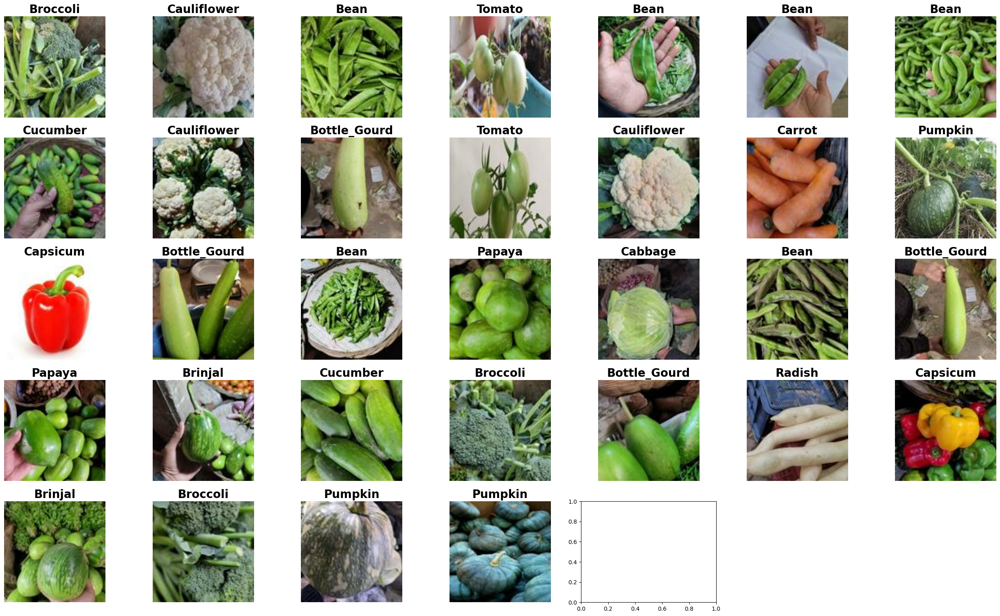

In [21]:
plot_images(data=ds_valid)

In [22]:
metrics = model.evaluate(ds_valid)
print_evaluation(ds_valid,metrics)

94/94 [==============================] - 1s 8ms/step - loss: 0.1776 - accuracy: 0.9627
Number of missclassified images in this data sample: 112 of 3008


2023-04-12 15:51:19.213596: W tensorflow/core/kernels/data/cache_dataset_ops.cc:856] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


InvalidArgumentError: slice index 32 of dimension 0 out of bounds. [Op:StridedSlice] name: strided_slice/

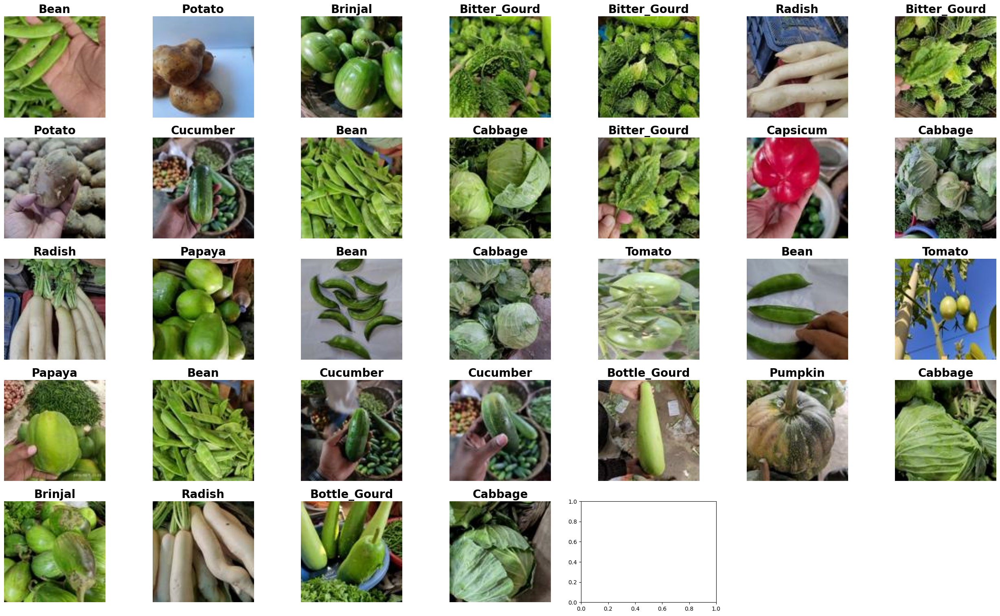

In [23]:
plot_images(data=ds_test)

In [24]:
metrics = model.evaluate(ds_test)
print_evaluation(ds_test,metrics)

94/94 [==============================] - 1s 8ms/step - loss: 0.1447 - accuracy: 0.9690
Number of missclassified images in this data sample: 93 of 3008


In [25]:
def make_list_of_batches(test_data):
    batches = []
    for batch in test_data.as_numpy_iterator():
        batches.append(batch)
    return batches

def sort_images_and_labels(batches):
    test_images = []
    test_labels = []
    for next_batch in batches:
        for image in next_batch[0]:
            test_images.append(image)
        for label in next_batch[1]:
            test_labels.append(label)
    return np.asarray(test_labels), np.asarray(test_images)

def label_probability_check(predicted):
    pred_max_prob = []
    for x in predicted:
        pred_max_prob.append(np.argmax(x))
    return pred_max_prob

def determine_class(test_images, predicted, true):
    true_class = list()
    false_class = list()
    for i in range(len(test_images)):
        if predicted[i] != true[i]:
            false_class.append((test_images[i], predicted[i], true[i]))
        else:
            true_class.append((test_images[i], predicted[i], true[i]))
    return true_class, false_class

def count_false_predictions(false_class):
    false_counts = {}
    for _, pred_label, true_label in false_class:
        if true_label not in false_counts:
            false_counts[true_label] = 1
        else:
            false_counts[true_label] += 1
    return false_counts

test_labels, test_images = sort_images_and_labels(make_list_of_batches(ds_test))
y_true = np.array(test_labels)
y_pred = label_probability_check(np.array(model.predict(test_images)))
true_class, false_class = determine_class(test_images, y_pred, y_true)
false_counts = count_false_predictions(false_class)

20/94 [=====>........................] - ETA: 0s

2023-04-12 15:51:27.961706: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


94/94 [==============================] - 1s 5ms/step


In [26]:
print(len(false_class))

93


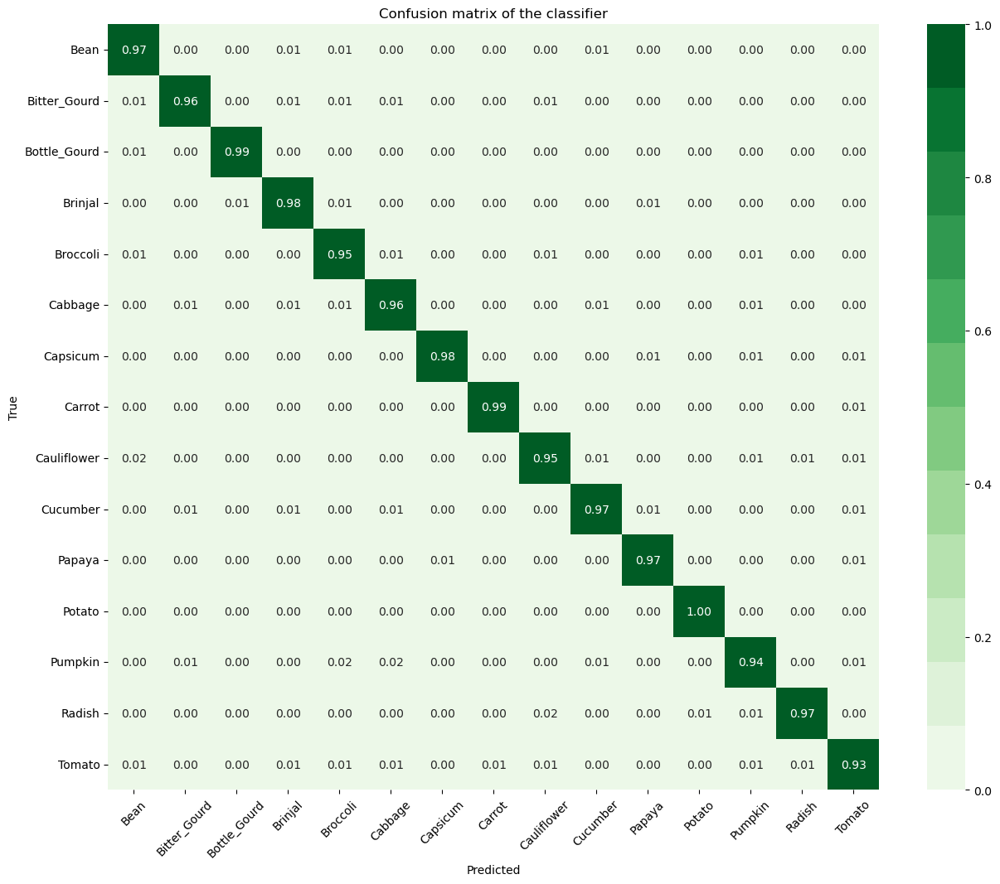

In [27]:
cm = confusion_matrix(y_true, y_pred, normalize='true')
plt.figure(figsize=(15,12))
plt.title('Confusion matrix of the classifier')
sns.heatmap(cm,annot=True,fmt=".2f",cmap=sns.color_palette("Greens",12),yticklabels=class_names,xticklabels=class_names)

plt.xticks(rotation=45)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

In [28]:
def plot_predictions(labels, cols):
    number_of_misscl = round((1 - metrics[1]) * len(ds_test) * CONFIG["batch_size"])
    random.shuffle(labels)
    rows = int(number_of_misscl/cols)-1
    fig = plt.figure(figsize=(10*cols, 10*rows))
    for i in range(1, cols*rows +1):
        fig.add_subplot(rows, cols, i)
        plt.title(f'Predicted: {class_names[labels[i][1]]}\nTrue: {class_names[labels[i][2]]}', fontsize=50,fontweight="bold",color="black")
        plt.axis("off")
        plt.imshow(np.uint8(labels[i][0] * 255.))
    plt.subplots_adjust(left=0.05, right=0.95, bottom=0.05, top=0.95, wspace=0.1, hspace=0.2)

In [29]:
plot_predictions(false_class, cols=7)

In [30]:
plot_predictions(true_class, cols=7)